In [1]:
from matplotlib import pyplot as plt
from skimage.color import rgb2hed, hed2rgb, separate_stains, hdx_from_rgb
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np
import os
import skimage

import warnings
warnings.filterwarnings('ignore')

In [9]:
input_dir = "/Users/Camilo/Desktop/U/Semestre 11vo/Seminario/Jupyter/HER2_images_pixel_segmentation/imgs/"
target_dir = "/Users/Camilo/Desktop/U/Semestre 11vo/Seminario/Jupyter/HER2_images_pixel_segmentation/labels/"
img_size = (200, 200)
num_classes = 1
batch_size = 32

input_img_paths = sorted(
    [
        os.path.join(input_dir, fname)
        for fname in os.listdir(input_dir)
        if fname.endswith(".png")
    ]
)
target_img_paths = sorted(
    [
        os.path.join(target_dir, fname)
        for fname in os.listdir(target_dir)
        if fname.endswith(".png") and not fname.startswith(".")
    ]
)

print("Number of samples:", len(input_img_paths))

Number of samples: 225


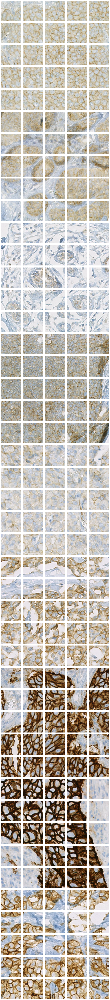

In [3]:
fig = plt.figure(figsize=(200, 200))
grid = ImageGrid(fig, 111,
                 nrows_ncols=(45, 5),
                 axes_pad=0.3,
                 )

for ax, im in zip(grid, [skimage.io.imread(input_img_paths[i]) for i in range(len(input_img_paths))]):
    ax.imshow(im)
    ax.axis('off')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

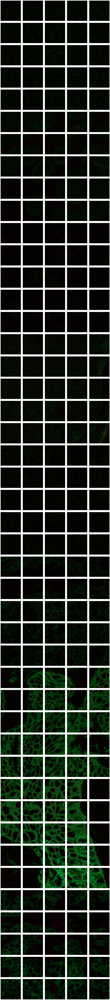

In [4]:
ihc_rgb = [skimage.io.imread(input_img_paths[i]) for i in range(len(input_img_paths))]
# ihc_hed = [rgb2hed(i) for i in ihc_rgb]
# ihc_d = [hed2rgb(np.stack((np.zeros_like(i[:, :, 0]), np.zeros_like(i[:, :, 0]), i[:, :, 2]), axis=-1)) for i in ihc_hed]

ihc_hdx = separate_stains(ihc_rgb, hdx_from_rgb)
# ihc_rgb_n = combine_stains(ihc_hdx, rgb_from_hdx)

fig = plt.figure(figsize=(200, 200))
grid = ImageGrid(fig, 111,
                 nrows_ncols=(45, 5),
                 axes_pad=0.3,
                 )

for ax, im in zip(grid, [i for i in ihc_hdx]):
    ax.imshow(im)
    ax.axis('off')
plt.show()

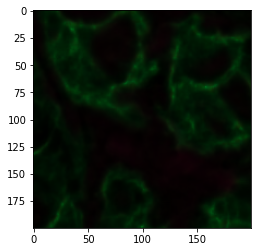

In [45]:
from skimage import data
from skimage.color import rgb2hed, hed2rgb
ihc = [skimage.io.imread(input_img_paths[i]) for i in range(len(input_img_paths))]
ihc_hed = separate_stains(ihc[224], hdx_from_rgb)
ihc_rgb = hed2rgb(ihc_hed)

plt.figure()
plt.imshow(ihc_hed)
plt.show()

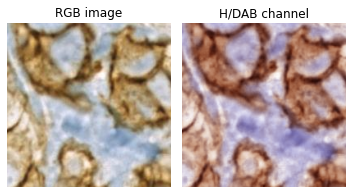

In [27]:
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(5, 4))

ax0.imshow(ihc[224])
ax0.set_title("RGB image")
ax0.axis('off')
ax1.imshow(ihc_rgb, cmap='hsv')
ax1.set_title("H/DAB channel")
ax1.axis('off')

fig.tight_layout()

plt.savefig('hdab_channel.png', bbox_inches='tight')

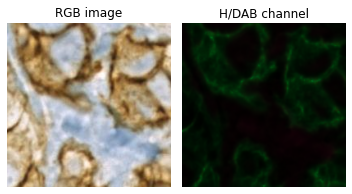

In [48]:
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(5, 4))

ax0.imshow(ihc[224])
ax0.set_title("RGB image")
ax0.axis('off')
ax1.imshow(ihc_hed, cmap='hsv')
ax1.set_title("H/DAB channel")
ax1.axis('off')

plt.savefig('hdab_channel2.png', bbox_inches='tight')

fig.tight_layout()